## はじめに
Jupyter Notebookはカーネルを切り替えることにより，様々な言語で開発することができます．ここでは，Rustのカーネル実装であるevcxr_jupyterを用いて，NotebookによるRust開発に挑戦してみます．


## やったこと
* evcxr_jupyterの導入
* 外部Crateの導入
* データ表示のカスタマイズ
* plottersによるグラフの描画

## evcxr_jupyterの導入

[jupyter-langs](https://github.com/HeRoMo/jupyter-langs)の[Rustに関する部分](https://github.com/HeRoMo/jupyter-langs/blob/6902893cb6375bf3149d2a67544700cbf7f016c8/Dockerfile#L81)をお借りしました．当該箇所を自分のDockerfileにコピペで特に問題なく動作しました．使用するだけならば，jupyter-langsを直接使うのが一番手っ取り早いと思います．それにしても，jupyter-langsはすごいですね．これだけカーネルを導入するのは色々と大変だったと思います．ありがたいです．


## 外部Crateの導入

外部Crateの導入はCode Cellに以下の様な記述を追加することで実現します．

```rust
:dep Crate名 = バージョン
```

初回評価時はコンパイルを行うため少し時間がかかります．以下に，[base64](https://crates.io/crates/base64)を導入する例を示します．

In [42]:
:dep base64 = "0.10.1"

//From Tour of the EvCxR Jupyter Kernel
//https://github.com/google/evcxr/blob/master/evcxr_jupyter/samples/evcxr_jupyter_tour.ipynb
base64::encode(&vec![1, 2, 3, 4])

"AQIDBA=="

## データ表示のカスタマイズ

evcxr_jupyterは以下のフォーマットでMIME Type と Content を標準出力に出力することで，HTMLに埋め込んで表示することが可能です．

```
EVCXR_BEGIN_CONTENT <<MIME Type>>

<< Content >>

EVCXR_END_CONTENT
```

具体的には，以下の様に表を出力したり，

In [16]:
println!(r#"EVCXR_BEGIN_CONTENT text/html
    
<table>
<tr>
<td>1</td>
<td>2</td>
<td>3</td>
</tr>
<tr>
<td>4</td>
<td>5</td>
<td>6</td>
</tr>
<tr>
<td>7</td>
<td>8</td>
<td>9</td>
</tr>
</table>
    
EVCXR_END_CONTENT"#);

1,2,3
4,5,6
7,8,9


画像を出力したりすることが可能です

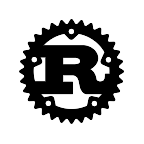

In [38]:
println!(r#"EVCXR_BEGIN_CONTENT image/png
    
iVBORw0KGgoAAAANSUhEUgAAAJAAAACQEAQAAAAd3/ZwAAAABGdBTUEAALGPC/xhBQAAACBjSFJNAAB6JgAAgIQAAPoAAACA6AAAdTAAAOpgAAA6mAAAF3CculE8AAAAAmJLR0T//xSrMc0AABKWSURBVHja7Z15eBRF+se/IeFSIkFgOTwICRIEFOQQBM8FFVHWC5afN8pyyLHoKrqgCAqIBEVAXcEbBEEQiIt4ggIKrAhClOWKhCQkIeQgIQkhJDPz/f0xsMNcSR9VXTOhP8/Tz5N0Vb/1vtXf6a6u6q6KIEnY2BiklmoHbMIbW0A2prAFZGMKW0A2prAFZGMKW0A2prAFZGMKW0A2prAFZGMKW0A2prAFZGMKW0A2prAFZGMKW0A2prAFZGMKW0A2prAFZGMKW0A2prAFFIQ3IoGICOD551V7EtqccwJaHOcWxsM5gGtH4Dx7VwB/d7n/nj4d+OneIMaOAM8sd9t7LV91ZIrgOUR5fxLwbMNIcqJ3Htc4Mn6Ydz6APNXJ396Li73zFHyjOkLrOaeuQBvv9v7/3Qhgwh/e+xY7gYPv+h/72oXe/7/RDZj8oPe+zyerjlABqhUsipymnivBJw6STv88vbP8rywAOXMqyf5kdkrg9DPbvgkk65AL3w6c3jCJ5Lf+5X61zpNn/z2qa0osNUZACw55n8yBX5DHizzpudOqFoeo7cBQT5nlF5JjbvFOf/YZ1TUllhpzC9tym/f/n90BNIwBtnUFSt8HZqRb48dzzYDjjYC9CcAF0cCb33qnr2+ruqbEEkHWjC9Tm3cAju5R7YU2XNlARAvVXoghbK5AR/sCmxYB5Uv80xy/hY94AKC0PEAM5wGb/wlk/J9q73Si+h6qhcKp3u2IWdHksZme9NwlctozbZbLsbt/nMf3ksXk/DLv9PTBqmtcO2EhoH0LAp+IsTPJH14hu30j9gS/vYZ03eEuu/Q38sGbxNpv5SLXfUJOSgicvvGk6hrXTli0gdKGAq0/sKasJjuBvGQAj3j2FZUCjaKti3fbHKD7OOvKM0NYtIHqWPjkMuAIvMQDADEF1sZb74S15ZkhPAT0onVlLR0AcIT3vsJF1sZb927zNqwiLAQUddC6ssqdwOxEwPm7+//iImBYJ2vjrbvS2vLMEDICmtXSPaodEQE8vAJYtQY4vBNwuoBlAn+RFzwPTLsU2JENlD4DpD/qn+fpGCDqSqDtbKBhI2Dlnf550icBJ6YAuw4BiTlAi0HifHwvA3AlA0c+BtZeA4zI8NTNE0vM2xeK6lb8GWQPMczbT2bFkyzwLzullz5bR9oHjuFoFLkgnazfTm4soUTIuHNle/EV3XMBufUu0jWg+vJ3axgri/kzmX+ThmB6kDvjyX77bQFZRiIFCucz8rcK/T7suC64zdjPyaIf9dtMaUb2f1VcbMPTVZ8pb0JGQNtzxFTwhgSSLuN+bB7hb7PzLLI0yVx8v4C88JT5+L7oqfpMeRMyAirJMlexkxuQ5U7zfpBk+mjyH7XJW64k3zxBOvLF2HU8Rc5NNhdn9iJ15ygQIdUTfV4ccPKQ/uO2XQd036Tae+3sTQc6/hNwLdN/rHMXUMviboWqsPwx/mhfYFNjYNt64LdNwIF4IC0NeKOPfvH0mgccc4WXeADg8lZA6Wrg3s/1Hzv5LSB9GnBgL/D7y8Avc4FN5QpH8a283PmOqpvZxvyJdITRoGNAniSnvi6uTlSM4kdZKda8LDF2pm0HnrscQD0rvZfAbOB5AM3rAMNGmzd3OBa41OIQLL2FXUagicOcjZlZwHNdAZxnpedy+dsoYOGD5u30mGe975Y3oteOAO54x9ixCfdY6akxLp4E9B4O3JgKXPUBEPMX7ce+PRAYZXAcbH4ZMKK+goCtvmdWbpLbzR9qW7e3yC9/JZ1R2urn2TXGyilZbPWZdKOkH+i9wepPrIpt/TXV143zP+T1r+uzOylBxVl0o2Q0vtcsFaWqp89W4P5+QFnr4Hlq9QCSdH4gcMNkhUFZJtUhZOkK8o8k8tqr1F8NVG7RL5M5l1RdXT9drN1eK5f7Rf3iVNKVbe0VSKqAMluRk0aTvTPVn7RQ3PK+rbr+xr5ksN31nvsLWCs+o5b3FLYbiHYCpZ0VXl5DnI49gZ0fAVEJgdNL3wei/2auDEdrIDJVXgzy2kBbgNIIeY7XBHb/B3h7cPD0BkOBmy4xVwYbyo1Baj/Qjnigm0T11xQKTwIxAXrV03YDra8wbverdUC/PnJ9l/oU1vUgkNhBbgA1gcVDAu9/zcTwxphb5IsHsKAn2rUG6LwL+P0F+cGEK5dsATKu8d5XdBRo1NyYvTqtgOISoK4F37NJ7weqNQD4+kf5gYQzh3sBZaO89y0qMW5vV11rxANYNBZWsQ+oe3ngtKmdgPGtgDqvAqnJwA2zgKxtnvR2kcDICd7H/PgosDLevF9Gxtb2r5JTR7lbgaY93X9XTgDqvOKd3vkiYFU3oOXtwKExwNVtgZLdgW0VxQANC+X46YfsfoK0E+So9YH7K9o8QTLJO/++Wv75dpd457n3oJh+mBQj/SQPkftvJQfVEdsnlPaEp4jPS/3Ti+t7u5HeNbitQRNPz5T2ra7IDCFFQMXdyU8jyNit1YzhXOF/rOOyABWyyjuPMAG9bSLI1eTcruIEVNTytN3pZNOHvdN6bQ3sQr3+VdtsmER+0FPu7LHCBbQkUXul9XrX//iC2wLnLX3Lk0eYgFLMxZq7R5yAnKfPxN55/mkRd5H0ebHfuUyf/VfzRJ9pN8Ib0aMaa8+7ZRjw/XTP/xVdgdGPBc6bc1T87Tuir7njGw0Q48fIH4Fap1ui2z72T2cS8OUc731LHq3OqjdPNxXjq79zgpm7V/+vr00R+UCXqvOURYq/Av0x1HicJPnzXEFXwpUem9s3BM83MJecv4j8yzX6yxj/qZwrkJQ20IJIsQ3Mjz/zti9MQEsNBLebzIkk32ktxodHXvKxv4zs8bTY+ntxMUlJo/TSHuOX5QD3mZyJ9I6NwPQjwJU+40UDU8U8xl9/rb78mQ8CqSPF1lPpFuB8n05E5/lA4hpgooCe5HldgbHbxfrshRxdulm70NgvZvxjZObVwe2KugKp3lKq+Szp5I/ksslk7Vhj9heaecrUiFQBkWSMjtvZ/O1k8UfV26wJAkreor0OXTPInzaRV2foK4N1ZJ9dyQLK1vjmYbMxZOVu7XbDWUD1HyLTvjRepykvk327aCtr3wSZZ9eNlLEwZxqwIB5ouVNb/oTNQNQ5MGr/yDag4E2g1W3GbbSZAMTeoS1vuxnAjD8DFZ3lxSRcQLvWA81SgZE63gNqYXDUOZzolgrM3gjUv8C8rabdtOed+ANQN7mKRfNMIlRA8zsBV/UFCnQ+PZwvqEMulNkeBzQeD6QI+LE06KX/mOtWyVm+U6iAXrrB2HERk8UHFqq0PQocMDmTBg3ORjJ9urHjqkKogOZuMXZc2V/FBxbKJHwKlD5m/PhTBn+o8yS0eIWaHLQdSPsZ6L1W33F5t4sPLNSZOkd73o1pwJf3e7Z8neOC8cOAPcuBsU4JgUh5tvsv+e9a2h9t49vrMx/Oj/Fnb3ldqo/12I3mylg0xr2QsCzkzA/UHhjgBIo7Ahf8t/rsB/cAWAlA0pNCMDZrjD7vYeDjEcDKHmLL/7ADML6aPDQxip59EGgRJ9Znfwcl02iStl9KuY6eWWHvAz2lL5Yj6eSF+eKuQNEZJAurLvOogbcb/tcTfbvssyt5coWFFwOFU7Xlzc+T/EsJxK36sje/FDjcErjsGn3HBaPkUiBvRdV5Dn9i3H5iTzF+VoU0Ac1dAAzRMaXd/p/kB+tLxC36jznvFLBA0FR9ALCnmlvUnqeM2352EjBhMIDnxPnri3gB7QemFABP6Hzt4QcJbxxWiwEBAcANOwDMFOPChszgaacOAg/HmLP/ynJg+HTAtUOMv36IvidOWmXsft2ypfYyhL1Q9qrxOBf1EdcW+i6fpM+L88eakSMGiivjoSOiz7Qb4S+UNXkWKEg0dmznxdrz7hIwKeX6x6vPE5MCdPnOf/+Bu4GEJPM+nKFeP2AUgOi2wIYkYGOGONtncOUBEU3E2hQuoG/6A/2+Eh+8ShzZQKTP25XlLYH6R1R7pp2PWwMPSpjoQngb6NYvgcpmwKa1wO01eJC0XjYQY3LuHtn0zgK+eRco7y9HPADk9wMVjiRnUH2vr5nNEeSF9Mf/rt63QNuTiWTuNNlnVlIbKBDOPwFRKvp5BBHoFgYASYnA3c+q9s6fknVAAwumdgEsmqk+9VNrgrGaLoK/0BDFnmesK0u6gCoI9JD5WYlCLrZwPXs99PgVKD5uTVnSBfR8XaDQwl+EldTKAYZIbwAYY+hPAFzyy5HaBvo+GejTWX4QsgnWBgKAQ52AuN9UexiYTxzAfZFyy5B3BWpVM8RTHa2TgVETVXsRmPujgIokuWXIE1A6EGdwVZ5w47VeQNRdqr0ITFSZXPtSb2HHmwKrC4Et7wPf/BXICNM1vqq6hZ0h6xjQZgdQbnCAVhTN2gP9XECvr4A7rwaa5Uou0JruJjeOX8n8MnLgneo72/Rszkht8RVPI4coWAek+9Nk7hKyMtnKs+lGyarNKT2Btj9rzz94HfCaia8YzFDvBaDxUH3HVJ4EctsZL/NfvYGXl2rP/0M2cKPJmVAMY71mydlL9f/K5txftc3K5WTFLhXRiGXZav11M3amOn8tF1D5W8Yv1au7um24niRzd5Ab3icnZ5Dt3vXkuc9JnmisrkIDUTCGHNuerD2ejJtFPteFXD+AzEklnYc9+Ta8YbxujikSkeUCWjbG3P2+n4aXyTo8qqYyA3GqN1m7Y9X+9rmJfLO3uXqZFa0mPkvbQK7jQGQfALJerzyL1NZA6xBY6GW1A7intjVlnVwM1HvA2vgsXfIyZRAsEQ8A7FhvZWTBWbPBurK2yfjytBosFdDFgq91LesCdweZ7vZrk1P4CiEPWBjktdnm94kvLmGRghitvmeW9iX3ZpCp68jMYjJ3Kln4JLnyZn33/FWDSDrdNstnkI/69L9E5pE8rqZdcIbi7/39njKbrDjdr1R4KXnnQ/rinl+HLMwm8+qTWa+Qhx4j9y0gC6eqiVHJY3xATpJRE7VVYseR/ocff8E/X8llakPa2dzHp0Ok02dizfzD+gTkcKqNyRcly34Hovh6wPGytry9X/TfFz3Gf98f36qNaXOa9//3PQ7U8lmZsHETIErH7P7ZyWpj8iVkBLRHx9JLyyYBLp+5iLIr/PNtvVFtTEnDvP//7HcAnbz3lXUDHDrW9volU3teKwgZAX03XHve4+8AL84FKoYDyANyZgD3BnhkX70ZKNyt3a5ISuYB63zWvajMAt7vB7DQ/X9FbWC8ztkzksrVxBMU1ffQM8QPN9iJdqj6PA8lk78+RjpbyI3BdT+5uyM5clT1Pt0yw3inYSihZDA1EBFBlgiPmqi9baSFcZ2BwWOBKy4HGgiYZaOsCNjbCFhxAph5vjg/63cDTgZ5lzw0ztj/nAkNPsp0/7rih5MvFZBbZ5DHu5M8qf8RX+sWM5p8PJZcEkP+kkEe3ksef4Us/8j9aoTjZ9KRQJ5qRxYPI7OuJncUk8tqk2OdZIsP5Pg17/QKjSVZ5PYcMpHkle3daYmSr6J6CZkrUFUU/QNo9LpqL6zj0CEgNla1F9oImUZ0VVReqNoDa6mw6KNAEYSFgCrGqfbAWso/VO2BdsJDQNvM2wgnyitVe6CdsBDQqSBfgM5eChzoAQy8U7WH+rj2C2DvVcB7gwOnl4fTxOuqW/FaKO171lNKV/dLaeVnreKcXybnaUjW9keSx/fKTeQXw8kmDk96Th/VNa6dsHgKA4ATNwOZEcBlK4BaDb3TnDuBqC6qPdRO6Qrg/IE+O0cCKRFA04uAGAmLosgibARUHa1Ohs93ZxwCIIwaylURFm0gLdy63H9fo0TgwPeAoykww6Kfyahk4NQRIOtm4IqX/NN7Z6LGiAdAeLSBtPChz9qs42uTp1ye9MKRVbdLtM6oH3NB1elpJzxlOv9NJnbwTp80WnVNiaXGCKioCRn3jvskrd8VOM/tAwKf9I8ucqcXd6haHNmnF0cJthp17NbA5W6PI5FMNthFZrZSXVNiqTEC0sKmtf4nfc587zzBVhmaH+edb+kR/zyfRqiO0HpqTCNaC47mQO2zZsSfnA9M8X0bcA9wbRqw+aw1zBqvB47GAZGx3lnfiQJGnPUlRHF3IPoc6/SUs9xTiBKVA3zdH3jgCmBUT2BKPgBfAbUHlpQCsWftWkd/8QDAcAdQvg94YQvwrwIgurq1m2og59QVSA8rugHjegEvbARGhth7yKGELSAbU9SYfiAbNdgCsjGFLSAbU9gCsjGFLSAbU9gCsjGFLSAbU9gCsjGFLSAbU9gCsjGFLSAbU9gCsjGFLSAbU9gCsjGFLSAbU9gCsjGFLSAbU9gCsjGFLSAbU/w/IpTqp4TSsCgAAAAldEVYdGRhdGU6Y3JlYXRlADIwMjAtMTEtMTFUMDE6MzQ6MTMrMDA6MDAnCoLDAAAAJXRFWHRkYXRlOm1vZGlmeQAyMDIwLTExLTExVDAxOjM0OjEzKzAwOjAwVlc6fwAAAABJRU5ErkJggg==
    
EVCXR_END_CONTENT"#);

また，`fn evcxr_display(&self)`となる関数（トレイト？）を任意の型に対して実装することで，その型をNotebookに出力することが可能となります．
以下に，`image::RgbImage`に対して，`fn evcxr_display(&self)`を実装した例を示します．

The type of the variable figure was redefined, so was lost.


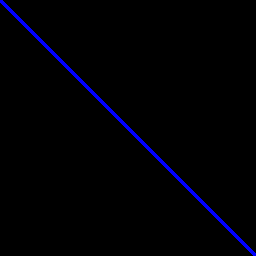

In [43]:
:dep image = "0.23"

//From Tour of the EvCxR Jupyter Kernel
//https://github.com/google/evcxr/blob/master/evcxr_jupyter/samples/evcxr_jupyter_tour.ipynb
extern crate image;
extern crate base64;
pub trait EvcxrResult {fn evcxr_display(&self);}
impl EvcxrResult for image::RgbImage {
    fn evcxr_display(&self) {
        let mut buffer = Vec::new();
        image::png::PNGEncoder::new(&mut buffer).encode(&**self, self.width(), self.height(),
            image::ColorType::Rgb8).unwrap();
        let img = base64::encode(&buffer);
        println!("EVCXR_BEGIN_CONTENT image/png\n{}\nEVCXR_END_CONTENT", img);        
    }
}

image::ImageBuffer::from_fn(256, 256, |x, y| {
    if (x as i32 - y as i32).abs() < 3 {
        image::Rgb([0, 0, 255])
    } else {
        image::Rgb([0, 0, 0])
    }
})

## plottersによるグラフの描画

plottersとはRustで記述されたグラフを描画するためのCrateです．詳細については，まだ作成途中とのことですが，[こちらの資料](https://plotters-rs.github.io/book/intro/introduction.html)に詳しくまとまっていました．また，日本語の資料としては，[こちらの記事](https://lab.mo-t.com/blog/rust-plotters)が大変わかりやすくまとまっていました．

以下に，プロット機能を用いて二次関数とマンデルブロ集合を描画する礼を示します．

In [ ]:
:dep plotters = { git = "https://github.com/38/plotters", default_features = true, features = ["evcxr"] }

In [11]:
// From Plotters Tutorial with Jupyter
// https://plotters-rs.github.io/plotters-doc-data/evcxr-jupyter-integration.html

extern crate plotters;
use plotters::prelude::*;

evcxr_figure((640, 480), |root| {
    root.fill(&WHITE);
    let mut chart = ChartBuilder::on(&root)
        .caption("y=x^2", ("Arial", 50).into_font())
        .margin(5)
        .x_label_area_size(30)
        .y_label_area_size(30)
        .build_ranged(-1f32..1f32, -0.1f32..1f32)?;

    chart.configure_mesh().draw()?;

    chart.draw_series(plotters::series::LineSeries::new(
        (-50..=50).map(|x| x as f32 / 50.0).map(|x| (x, x * x)),
        &RED,
    )).unwrap()
        .label("y = x^2")
        .legend(|(x,y)| PathElement::new(vec![(x,y), (x + 20,y)], &RED));

    chart.configure_series_labels()
        .background_style(&WHITE.mix(0.8))
        .border_style(&BLACK)
        .draw()?;
    Ok(())
})

Fontconfig error: Cannot load default config file
Fontconfig error: Cannot load default config file
Fontconfig warning: ignoring C.UTF-8: not a valid language tag


y=x^2
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
0.0
 
 
 
0.2
 
 
 
0.4
 
 
 
0.6
 
 
 
0.8
 
 
 
 
-0.8
 
 
 
-0.6
 
 
 
-0.4
 
 
 
-0.2
 
 
 
0.0
 
 
 
0.2
 
 
 
0.4
 
 
 
0.6
 
 
 
0.8
 
 
 
1.0
 
 
<polyline fill="none" opacity="1" stroke="#FF0000" stroke-width="1" points="35,55 41,68 47,81 53,95 59,108 65,121 71,133 77,146 83,158 89,170 95,181 101,192 107,203 113,214 119,224 125,234 131,244 137,254 143,263 149,272 155,280 161,289 167,297 173,305 179,312 185,319 191,326 197,333 203,339 209,346 215,351 221,357 227,362 233,367 239,372 245,376 251,380 257,384 263,388 269,391 275,394 281,397 287,399 293,401 299,403 305,405 311,406 317,407 323,407 329,408 335,408 341,408 347,407 353,407 359,406 365,405 371,403 377,401 383,399 389,397 395,394 401,391 407,388 413,384 419,380 425,376 431,372 437,367 443,362 449,357 455,351 461,346 467,339 473,333 479,326 485,319 491,312 497,305 503,297 509,289 515,280 521,272 527,263 533,254 539,244 545,234 551,224 557,214 563,203 569,192 575,181 581,170 587,158 593,146 599,133 605,121 611,108 617,95 623,81 629,68 635,55 "/>
 
 
 
y = x^2

In [15]:
// From mandelbrot.rs
// https://github.com/38/plotters/blob/master/examples/mandelbrot.rs

use plotters::prelude::*;
use std::ops::Range;

fn mandelbrot_set(
    real: Range<f64>,
    complex: Range<f64>,
    samples: (usize, usize),
    max_iter: usize,
) -> impl Iterator<Item = (f64, f64, usize)> {
    let step = (
        (real.end - real.start) / samples.0 as f64,
        (complex.end - complex.start) / samples.1 as f64,
    );
    return (0..(samples.0 * samples.1)).map(move |k| {
        let c = (
            real.start + step.0 * (k % samples.0) as f64,
            complex.start + step.1 * (k / samples.0) as f64,
        );
        let mut z = (0.0, 0.0);
        let mut cnt = 0;
        while cnt < max_iter && z.0 * z.0 + z.1 * z.1 <= 1e10 {
            z = (z.0 * z.0 - z.1 * z.1 + c.0, 2.0 * z.0 * z.1 + c.1);
            cnt += 1;
        }
        return (c.0, c.1, cnt);
    });
}

evcxr_figure((640, 480), |root| {
    root.fill(&WHITE);

    let mut chart = ChartBuilder::on(&root)
        .margin(20)
        .x_label_area_size(10)
        .y_label_area_size(10)
        .build_cartesian_2d(-2.1f64..0.6f64, -1.2f64..1.2f64)?;

    chart
        .configure_mesh()
        .disable_x_mesh()
        .disable_y_mesh()
        .draw()?;

    let plotting_area = chart.plotting_area();

    let range = plotting_area.get_pixel_range();

    let (pw, ph) = (range.0.end - range.0.start, range.1.end - range.1.start);
    let (xr, yr) = (chart.x_range(), chart.y_range());

    for (x, y, c) in mandelbrot_set(xr, yr, (pw as usize, ph as usize), 100) {
        if c != 100 {
            plotting_area.draw_pixel((x, y), &HSLColor(c as f64 / 100.0, 1.0, 0.5))?;
        } else {
            plotting_area.draw_pixel((x, y), &BLACK)?;
        }
    }
    Ok(())
})

Fontconfig error: Cannot load default config file
Fontconfig error: Cannot load default config file
Fontconfig warning: ignoring C.UTF-8: not a valid language tag


-1.0
 
 
 
-0.5
 
 
 
0.0
 
 
 
0.5
 
 
 
1.0
 
 
 
 
-2.0
 
 
 
-1.5
 
 
 
-1.0
 
 
 
-0.5
 
 
 
0.0
 
 
 
0.5
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 


## 参考
1. [evcxr](https://github.com/google/evcxr)
1. [jupyter-langs](https://github.com/HeRoMo/jupyter-langs)
1. [RustのドローイングライブラリPlottersの紹介](https://lab.mo-t.com/blog/rust-plotters)